# Import Statements

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as ms

# Data Understanding

In [2]:
# reading in datasets
tr_df = pd.read_parquet("/mnt/c/users/efazh/DataProblems/Datasets/Tabular/Single_Cell/de_train.parquet")

In [3]:
print("Shape of Training Set:",tr_df.shape)

Shape of Training Set: (614, 18216)


In [4]:
# outputing first 5 rows of dataset
tr_df.head()

,cell_type,sm_name,sm_lincs_id,SMILES,control,A1BG,A1BG-AS1,A2M,A2M-AS1,A2MP1,...,ZUP1,ZW10,ZWILCH,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11B,ZYX,ZZEF1
0,NK cells,Clotrimazole,LSM-5341,Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1,False,0.104720,-0.077524,-1.625596,-0.144545,0.143555,...,-0.227781,-0.010752,-0.023881,0.674536,-0.453068,0.005164,-0.094959,0.034127,0.221377,0.368755
1,T cells CD4+,Clotrimazole,LSM-5341,Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1,False,0.915953,-0.884380,0.371834,-0.081677,-0.498266,...,-0.494985,-0.303419,0.304955,-0.333905,-0.315516,-0.369626,-0.095079,0.704780,1.096702,-0.869887
2,T cells CD8+,Clotrimazole,LSM-5341,Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1,False,-0.387721,-0.305378,0.567777,0.303895,-0.022653,...,-0.119422,-0.033608,-0.153123,0.183597,-0.555678,-1.494789,-0.213550,0.415768,0.078439,-0.259365
3,T regulatory cells,Clotrimazole,LSM-5341,Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1,False,0.232893,0.129029,0.336897,0.486946,0.767661,...,0.451679,0.704643,0.015468,-0.103868,0.865027,0.189114,0.224700,-0.048233,0.216139,-0.085024
4,NK cells,Mometasone Furoate,LSM-3349,C[C@@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C...,False,4.290652,-0.063864,-0.017443,-0.541154,0.570982,...,0.758474,0.510762,0.607401,-0.123059,0.214366,0.487838,-0.819775,0.112365,-0.122193,0.676629


In [7]:
# Check data types
data_types = tr_df.dtypes

# Print data types along with additional information
print("Data Types and Additional Information:")
for column in tr_df.columns:
    print(f"Column: {column}")
    print(f" - Data Type: {data_types[column]}")
    print(f" - Number of Unique Values: {tr_df[column].nunique()}")
    print(f" - Sample Values: {tr_df[column].dropna().unique()[:5]}")  # Display first 5 unique non-null values
    print()

Data Types and Additional Information:
Column: cell_type
 - Data Type: object
 - Number of Unique Values: 6
 - Sample Values: ['NK cells' 'T cells CD4+' 'T cells CD8+' 'T regulatory cells' 'B cells']

Column: sm_name
 - Data Type: object
 - Number of Unique Values: 146
 - Sample Values: ['Clotrimazole' 'Mometasone Furoate' 'Idelalisib' 'Vandetanib' 'Bosutinib']

Column: sm_lincs_id
 - Data Type: object
 - Number of Unique Values: 146
 - Sample Values: ['LSM-5341' 'LSM-3349' 'LSM-1205' 'LSM-1199' 'LSM-1190']

Column: SMILES
 - Data Type: object
 - Number of Unique Values: 146
 - Sample Values: ['Clc1ccccc1C(c1ccccc1)(c1ccccc1)n1ccnc1'
 'C[C@@H]1C[C@H]2[C@@H]3CCC4=CC(=O)C=C[C@]4(C)[C@@]3(Cl)[C@@H](O)C[C@]2(C)[C@@]1(OC(=O)c1ccco1)C(=O)CCl'
 'CC[C@H](Nc1ncnc2[nH]cnc12)c1nc2cccc(F)c2c(=O)n1-c1ccccc1'
 'COc1cc2c(Nc3ccc(Br)cc3F)ncnc2cc1OCC1CCN(C)CC1'
 'COc1cc(Nc2c(C#N)cnc3cc(OCCCN4CCN(C)CC4)c(OC)cc23)c(Cl)cc1Cl']

Column: control
 - Data Type: bool
 - Number of Unique Values: 2
 - Sample Valu

 - Sample Values: [-0.00489394 -0.05470926 -0.468346    0.70443384  0.86790696]

Column: AC008403.3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 4.85003944e-01  2.87993501e-02 -9.22432429e-04  9.42934500e-01
  1.46618910e+00]

Column: AC008417.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.00634111 -0.60544106 -0.50729617  1.08721452  0.29213017]

Column: AC008429.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.20508444  0.0408662  -0.54193961  0.77312379  0.11833892]

Column: AC008440.2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.06527321  0.01605846 -0.55350771  0.64254471  1.01104106]

Column: AC008443.4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.25802573 -0.02213144 -0.70503611  0.61318674 -0.20672371]

Column: AC008467.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.14962703  1.7392777   0.04193599 

 - Sample Values: [ 0.26938699  0.41216426 -0.11481151  0.72200341  0.59901116]

Column: AC011337.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.95265151  0.42426055 -0.42204686  0.45946698  2.07306509]

Column: AC011342.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.5491806   0.52310232 -0.43839411  0.71401201  2.60839449]

Column: AC011374.2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.17651831  0.12027136 -0.3639161   0.37083969 -0.1241861 ]

Column: AC011379.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.09998649  0.37436467 -0.41077498  0.6982312   1.67903453]

Column: AC011379.2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.08734344  0.90484634 -0.14153378  0.21767631  0.5836386 ]

Column: AC011405.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.40529263  1.26323731 -0.89102028  0.38199017  1.782992

 - Sample Values: [ 2.4175971  -0.33879709 -0.149726    0.68101339  0.25635529]

Column: AC034111.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.29327102  0.18575332 -0.46989236  0.45252736  0.16230813]

Column: AC034199.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.63366873  0.19315994 -0.37943499  0.72677084  3.21028213]

Column: AC034231.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.65077262  0.06684169 -0.41916353  0.66329047  1.34146578]

Column: AC034236.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-1.22200198  0.18449285 -0.62666782 -1.42666513  0.37972093]

Column: AC034236.2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.15331301  0.41696145 -0.26481388  0.23641681 -0.04999655]

Column: AC034238.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.01884758 -0.65198088  0.08866862  0.64010988 -0.578518

 - Sample Values: [ 0.44348317  1.37674478 -0.39330811  0.65536047  2.28536065]

Column: AC095057.3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.05594045  0.49547058  0.62762932  1.06031101  0.43850845]

Column: AC096558.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.39872629  0.46690949 -0.31528809  1.30772191  2.05327922]

Column: AC096558.2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.04563964 -0.0372365   0.17686929  0.65601069  1.56389275]

Column: AC096564.2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.88304692  0.252739   -1.01382673  0.71054526  1.92709592]

Column: AC096586.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.01247816  0.25227147 -0.60773534  0.67677743  0.66041638]

Column: AC096642.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.26592065  0.4526744  -0.69195201  0.52957897  0.636936

 - Number of Unique Values: 614
 - Sample Values: [-0.08462114 -0.07474532 -0.13735607  0.25221453  1.49691867]

Column: AC137630.3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.22051138  0.85085936 -0.69791759  0.8008828   0.41392248]

Column: AC137630.4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.0753794   0.27146721 -0.41322609  0.60562917  1.83620761]

Column: AC137723.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.9847566   0.97510146 -0.29257922  0.80003395  0.99873353]

Column: AC137767.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.06563294 -0.26115851  0.16048576  0.30591853  0.55302979]

Column: AC137932.3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.74353336 -0.93321486 -0.71058077 -0.26399519  0.95776644]

Column: AC138028.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.40707727 -0.70236363 -

 - Number of Unique Values: 614
 - Sample Values: [ 0.42196208  0.99885434 -0.86884008  0.33997035  0.90115434]

Column: AGO4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.28824521 -0.43484545 -0.55577759 -0.15242654  0.12732733]

Column: AGPAT1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.02432033  0.17189706 -0.32834057 -0.04744657 -0.24851332]

Column: AGPAT2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.47516151 -0.00825    -0.30324112 -0.13060558 -1.72084104]

Column: AGPAT3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.21420213  0.14160392  0.31203564  0.01562509 -0.24513623]

Column: AGPAT4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.21383397  0.40264342 -0.780084    0.35639296  1.92699633]

Column: AGPAT4-IT1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.53831894  1.08035972 -0.52927506  0.41241325

 - Sample Values: [ 0.39369555  0.30682932 -0.37784456  2.45747188 -0.08054212]

Column: AL158055.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.6345567   0.19337399 -0.42709646  0.77263141  3.24203241]

Column: AL158071.2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.09409252  0.13930035 -0.63088198  0.71735672  6.13246642]

Column: AL158071.3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.06326085  0.19712863 -0.44518959  0.72185099  1.83827308]

Column: AL158151.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.46264157 -0.50230429 -0.39429509  0.69255945  2.7426221 ]

Column: AL158152.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.00499459 -1.69972568  0.46075462  1.39326859  0.62960784]

Column: AL158163.1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.48673833 -0.02318102 -0.34344677  0.23498593  1.133372

 - Sample Values: [-0.03800316 -0.43563849  0.23122037  0.11527218  1.26851948]

Column: ALKBH5
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.00556142 -0.28128154 -0.4332846  -0.01162325 -0.43345025]

Column: ALKBH6
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.89994746  0.05121527 -0.03362884  0.48732073  0.14432622]

Column: ALKBH7
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.0898605   0.46564392 -0.07247443 -0.06191    -0.03147739]

Column: ALKBH8
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.66150007  0.21083685 -0.11288004  0.93334851 -0.13252477]

Column: ALMS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.15238182 -0.34581932  0.16364491  0.52870913 -0.2298893 ]

Column: ALMS1-IT1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.49122607  2.3570579  -0.37987426  0.64403492  0.29586243]

Column: ALMS1P1
 

 - Number of Unique Values: 614
 - Sample Values: [-0.044877    0.02237277 -0.01460654  0.2549622   0.07501978]

Column: APPL2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.17442291  0.32259383  0.17124128  0.18952298  0.38513373]

Column: APRT
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.84439651  0.07298189 -0.13800214  0.34617091 -2.60654352]

Column: APTR
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.6111746   1.25291682 -1.01506271  1.29503495  0.04364141]

Column: APTX
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.67472653 -0.03221766  0.12208823  0.03429795  0.10242273]

Column: AQP10
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.6336588   0.03371547 -0.53738266  0.66680532  2.86736658]

Column: AQP11
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.20195695  0.38774799 -0.72777751  0.41037916  0.4175910

 - Number of Unique Values: 614
 - Sample Values: [-2.0119488   0.57858834 -0.02252575 -0.03079344 -0.01370907]

Column: BAG6
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.75483003 -0.25188925  0.63628444  0.7552391  -0.67462371]

Column: BAHCC1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.03583855 -0.00268255 -0.43087526  0.71079462  1.73505045]

Column: BAHD1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-1.28495343 -0.08670808  0.70356064 -0.01178415  0.26040581]

Column: BAIAP2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [0.06828537 0.06119701 0.16369302 0.64363132 0.54453322]

Column: BAIAP2-DT
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.32267609 -0.32263929 -0.10036327  0.44322088  0.13156165]

Column: BAIAP2L1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.2989195   0.36179045 -0.51299951  0.67866744  2.0

 - Sample Values: [0.03151931 0.23711687 0.4252249  0.75833239 1.82952611]

Column: C20ORF144
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.50702784  0.10326598 -0.68519826  0.74943787  2.02266029]

Column: C20ORF194
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.84008786 -0.1431583  -0.02165725 -0.02894753  0.42639692]

Column: C20ORF197
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.31918057 -0.10258174 -0.43674237  0.43502944  0.49599177]

Column: C20ORF204
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.20231886 -0.01232758 -0.57006097  0.17309528  0.1749851 ]

Column: C20ORF27
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.25655854 -0.12268042 -0.20141253  0.16223014 -0.25859103]

Column: C20ORF96
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.53172839  0.79916145 -0.70822075  0.31311564 -0.01877101]

Column: 

 - Sample Values: [ 0.60508375  0.12231694 -0.79693061 -0.21154388 -0.16206157]

Column: CCDC47
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.08186478 -0.49192222  0.02127248 -0.40559849 -0.54227038]

Column: CCDC50
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.23188935 -0.00287566 -0.35751677 -0.97420768  1.13048003]

Column: CCDC51
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.4923797  -0.08866853 -0.72962692  0.404268    1.04490832]

Column: CCDC57
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-1.16806717 -0.20853793 -0.03189548  0.09254692 -0.15665792]

Column: CCDC58
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 2.01397379 -0.30157268  0.15106431  0.24716282  0.16914946]

Column: CCDC59
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.01010163 -0.34506356 -0.20166745 -1.138369    0.63569231]

Column: CCDC6
 - Da

 - Number of Unique Values: 614
 - Sample Values: [ 0.03506023 -0.57519459 -0.58731069  0.49134599  1.09598533]

Column: CFAP54
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.05946701  0.49464805 -0.45969659  0.72760882  0.87031512]

Column: CFAP58-DT
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.30681236  0.14229935 -0.42855783  0.72185099  2.70083692]

Column: CFAP70
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.53306667 -0.86257489 -0.40276871  0.68963898  1.20536802]

Column: CFAP97
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.04581249 -0.32579001  0.690727   -0.09771704 -2.27779672]

Column: CFAP97D2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.00294249 -0.05657734 -0.07183692  0.72002071  2.14666165]

Column: CFB
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.09288996  0.04114933 -0.42116667  0.71722715

 - Sample Values: [-0.22334443 -0.24180462  0.27581947  0.37510964 -0.01241657]

Column: CMKLR1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.28181618  0.29596306 -0.59264232  0.62795884 -0.75746028]

Column: CMPK1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-1.12637024  0.04081751  0.01204615  0.29424766  0.19962735]

Column: CMPK2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-1.03242511 -1.12825268 -0.5124605  -0.40446288 -0.3450565 ]

Column: CMSS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.00221185  0.03355129  0.72465381 -0.2860502   0.03292056]

Column: CMTM3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.44833614 -0.47070829  0.37733181 -0.06069632  0.31769661]

Column: CMTM4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.35763793 -0.16824453 -0.98409895  0.57441685  1.3380429 ]

Column: CMTM6
 - Data Ty

 - Number of Unique Values: 614
 - Sample Values: [-0.13260209 -0.15000995 -0.01248416  0.9234612   4.27334111]

Column: CYB5D2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.0030179  -0.36371582  0.19260274 -0.21208243  0.21755618]

Column: CYB5R1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.03306456  0.42555955 -0.8165441   0.01094701  0.77850217]

Column: CYB5R2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.06316163 -0.10172382 -0.64547392  0.71895996  1.47902695]

Column: CYB5R3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.54348225  0.4658463   0.41658307 -0.27985545 -1.57431537]

Column: CYB5R4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.50184676  0.26720857 -0.14191017 -0.21445528 -0.22660114]

Column: CYB5RL
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.32833722  0.0908207  -0.05043661  1.07353771  

 - Sample Values: [ 5.95937037e-01 -1.31928937e-03 -4.59846729e-01  7.09058285e-01
  3.01887861e+00]

Column: DOC2GP
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.81488497  0.20917294 -0.77270792 -0.06026431  0.77911693]

Column: DOCK1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.41615452 -0.13742318 -0.42934308  0.60648349  2.7859514 ]

Column: DOCK10
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.93976928 -0.52393339  0.27822244  0.25191101 -0.73415421]

Column: DOCK11
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.54652731  0.04084184 -0.32750526  0.02192178  0.15649624]

Column: DOCK2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.10781085  0.10987438  0.28695761 -1.32972221 -1.39112644]

Column: DOCK3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.13354402 -0.02903008 -0.46254039  0.72185099  1.84628486]

C

 - Number of Unique Values: 614
 - Sample Values: [ 1.72068765  0.03439324  0.01855293  0.04619724 -0.45754688]

Column: EOGT
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.15987386 -0.50049605 -0.41708115  1.77959993  1.41273572]

Column: EOMES
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.09406603  0.47390748  0.02256674  0.6959807  -1.36189668]

Column: EP300
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.26007622  0.21793766 -0.12420135  0.23898061  0.01431683]

Column: EP400
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.11092718 -0.79477276 -0.29645339 -0.0797138   0.38517573]

Column: EP400P1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.26697299  0.06830671  0.85269534  0.08484103  0.71529382]

Column: EPAS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.23347771 -0.02466086 -0.34986096  0.69334487  1.773

 - Sample Values: [ 0.13260764  0.38533094 -0.32129849  0.12948944  0.03917363]

Column: FASTKD2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.2280394  -0.33888433  0.54588601  0.73861371  0.91628001]

Column: FASTKD3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.07913985 -0.02797269 -0.27547641 -0.15889275 -0.4510495 ]

Column: FASTKD5
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.40802179  0.42894589 -0.1986643  -0.1034005   0.67720296]

Column: FAU
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.02782804  0.13374453  0.83031168 -0.29229245  0.25862657]

Column: FAUP1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.00553917 -0.17126031 -1.31127658 -0.0612328   0.2201407 ]

Column: FAXC
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.1525362   0.20156703 -0.61752064  0.92979676  1.03632581]

Column: FAXDC2
 - Data

 - Number of Unique Values: 614
 - Sample Values: [ 0.62740344  0.29314891 -0.03504191  0.35397222 -0.13974021]

Column: GATB
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.54151001 -0.02445504 -0.51754218  0.11595779 -0.27225114]

Column: GATC
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.23571903  0.04405501 -0.49092155  0.34320023  0.29015064]

Column: GATD1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.45951064  0.36563683  0.06548734 -0.02117593  0.23538639]

Column: GATD3A
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.2365107  -0.42170348 -0.34584478  0.73450207  1.58728601]

Column: GATD3B
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.00381155  0.0488525  -0.30273213 -0.00399316  0.1461438 ]

Column: GATM
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.30805809  0.14632088 -1.00193095  0.65650489  2.58157

 - Sample Values: [-0.07549392 -0.35616527 -0.21445992  0.32045896 -0.00424094]

Column: GSDMD
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.25763252 -0.12223079 -0.96815592 -0.14143912 -0.54593325]

Column: GSDME
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.17882661 -0.81743349 -0.45304942  0.75862623  1.79072243]

Column: GSE1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.23844298 -0.08381324 -0.04584034  0.49215723 -0.74525513]

Column: GSEC
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.84973099 -0.36548041  0.54745383  0.01016023 -1.7026363 ]

Column: GSG1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.14530007  0.0256514  -0.66669217  0.71419555  2.7904391 ]

Column: GSK3A
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.498417    0.43373241 -1.50093938  0.0270381   1.18131769]

Column: GSK3B
 - Data Type: 

 - Number of Unique Values: 614
 - Sample Values: [ 0.1131381  -0.02797852  1.45593468  0.45894388  0.05754694]

Column: HNRNPA1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.8576461  -0.27315292 -0.0123414  -0.04047534 -0.74572092]

Column: HNRNPA1L2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.28981768  1.55455253 -0.07847463 -0.22641748 -0.05202742]

Column: HNRNPA1P34
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.14473929  0.22288656 -0.85404889  0.68288515  0.09050375]

Column: HNRNPA1P40
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.79129251  0.26939063  0.02485078  0.06911754 -0.01752472]

Column: HNRNPA1P48
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.19819124 -0.72885238 -1.09086577  0.25137273  0.47047357]

Column: HNRNPA1P76
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.63574805 -0.2865735  -0.50

 - Sample Values: [-0.21970088  0.02944894 -0.29661951  0.1195562   0.19833411]

Column: INTS4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.08229282 -0.11134389  0.09418215  0.48200747 -0.57273079]

Column: INTS5
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.48535884  0.06038931 -0.13362375  0.50501024  1.62333773]

Column: INTS6
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.17977126  0.51631596 -1.05042063  0.67969818  0.48875878]

Column: INTS6-AS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.28954306  0.31665311  0.5157139  -0.46077603  1.17756416]

Column: INTS6L
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.02599973  0.61204948 -0.11898972  0.63934267  0.24824093]

Column: INTS7
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.29457527 -0.30774043 -0.23136841 -0.03601367 -0.05866136]

Column: INTS8
 - Dat

 - Sample Values: [-0.04891597  0.16413587 -1.09383716  0.42692122  0.88444185]

Column: KLHL32
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.68985796  0.21400298 -0.74876988  0.66631166  2.57559605]

Column: KLHL34
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.47947967 -0.37090088 -0.54835318  0.40411593  2.59613972]

Column: KLHL35
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.06282582 -0.48861482 -0.55523698  0.26984403  1.20292682]

Column: KLHL36
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.17094918 -0.64246202 -0.05986077 -0.5164638   0.01798354]

Column: KLHL42
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.26211836 -0.69797727 -0.61806495  0.90599238  0.97994077]

Column: KLHL5
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.25718538 -0.22510855 -0.4421208   2.00893362 -0.40039257]

Column: KLHL6
 - Dat

 - Sample Values: [ 1.83081555  0.89285949 -0.40641654 -0.39254094  1.85117939]

Column: LINC01624
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.703546   -0.05490189  0.01584915  0.74875931  3.12373565]

Column: LINC01635
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.57554326  0.90962681 -0.33541029  0.70752961  2.47047308]

Column: LINC01637
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.24214423 -0.10209796 -0.55697666  0.71346912  1.26255924]

Column: LINC01644
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.05490979  0.58798056 -0.29446364  0.74616215  0.1151005 ]

Column: LINC01675
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.74200312  0.05154387 -0.37736147  0.40694774  1.25531459]

Column: LINC01678
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.0045816  -0.46609614 -0.38729516  0.13079592  1.20624659]

C

 - Sample Values: [-0.3633195  -0.16847225 -0.04805662 -0.0837851  -0.90733807]

Column: MAP3K21
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.04104377 -0.49292161  0.54325785  0.55219597  0.16602838]

Column: MAP3K3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-1.33068572  0.48165043  0.30430111  0.85454549  0.21925396]

Column: MAP3K4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.42022337 -0.26625368  0.53565823  0.08951731  0.39836211]

Column: MAP3K5
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.34113557 -1.06600869 -0.52923476  0.75418855  0.20475756]

Column: MAP3K6
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.25396612 -0.64981046 -0.2841562   0.27133522 -0.89856307]

Column: MAP3K7
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.59907233  0.44964221 -0.64481187  2.17475884  0.37339007]

Column: MAP3K7CL
 

 - Sample Values: [-0.33873301 -0.18723184 -0.71776038 -0.54611731  0.3599567 ]

Column: MKRN2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.37302114 -0.19640871 -0.0465747   0.00555375  0.92585477]

Column: MKRN3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.65776115  0.25856115 -0.42897487  0.72200112  2.39355619]

Column: MKS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.34600722 -0.23204861 -0.09374509  0.40476601  0.44381016]

Column: MLC1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.97307791  0.06554429 -0.65212546  0.72363504  0.43218994]

Column: MLEC
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.4386     -0.20147808  0.2170492  -0.07639444 -1.01467535]

Column: MLF1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.76562239 -0.08976402 -0.1502696   0.21652079 -0.04676525]

Column: MLF2
 - Data Type: fl

 - Number of Unique Values: 614
 - Sample Values: [-0.31468656  0.52148345 -0.45016092  0.61530354  2.03629613]

Column: MYO5C
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.13545729 -0.50724516 -0.48171596  0.56123686  1.92517895]

Column: MYO6
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.24470502 -0.34725844 -0.01793002  0.57570878 -0.45110095]

Column: MYO7A
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.55762517  0.39992021 -0.43057769  0.66419131  2.79046765]

Column: MYO9A
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.06649296  0.32036176 -0.35743036  0.24203904 -0.20894086]

Column: MYO9B
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.42115279 -0.64014802 -0.70113434  0.02478562 -0.20507249]

Column: MYOF
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.21236396  0.5305788  -0.44498601  1.33325794  2.011202

 - Sample Values: [-0.1141023   0.13885863 -0.42374213  0.68506618  4.05044308]

Column: NOP10
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.46810477 -1.0203249   0.02497262 -0.35359257 -1.37992461]

Column: NOP14
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.0354648   0.51846928 -0.10783522 -0.62013059 -0.30883933]

Column: NOP14-AS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.19900002  0.0290854   1.09616698 -0.29961472  0.00982892]

Column: NOP16
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-4.51198920e-01  2.80162593e-02  2.59228947e-04 -3.18052034e-02
  9.70513008e-02]

Column: NOP2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.13927255  0.45912067  0.11803823  0.45313109  0.03361717]

Column: NOP53
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.05227723  0.78301831 -0.23528264  0.47486892  0.85198821]

C

 - Sample Values: [-0.35371761 -0.20743163 -0.81739698 -0.18465756  0.48782393]

Column: PAN3-AS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.42299524 -0.07649394  0.28158028 -0.10283195  0.93702481]

Column: PANK1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [0.04663754 0.00159216 0.30768966 0.1684471  0.16541521]

Column: PANK2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.29013764  0.34491194 -0.10839716 -0.0337052   0.33663104]

Column: PANK3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.64875709 -1.69848096  0.28239803  0.19835668 -0.02793184]

Column: PANK4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.31399604 -0.08789    -0.10975771 -0.27077826  0.2813658 ]

Column: PANO1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.11422078  0.16275145 -1.37159088  0.50805626  1.03643651]

Column: PANX1
 - Data Type:

 - Number of Unique Values: 614
 - Sample Values: [ 0.10988964  0.77491892  0.00843035 -0.02086961  0.24549885]

Column: PIP4P2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.09475893  1.34157289 -0.26098597 -0.17797588 -0.27760984]

Column: PIP5K1A
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.08269787  0.14704249  0.19533397 -0.07753941  1.28914508]

Column: PIP5K1B
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.08943246  0.03086257 -0.53866927  1.65158142  1.80381804]

Column: PIP5K1C
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.00450468  0.13434975  0.35489301  1.5280461   0.54646917]

Column: PIP5KL1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.04863341  0.45960785 -0.11878914  0.68868553  1.71290679]

Column: PIPOX
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.0660289  -0.11464346 -0.04438782  0.6939509

 - Number of Unique Values: 614
 - Sample Values: [-0.49691096 -0.22330004 -0.84602539 -0.26793626 -0.19546127]

Column: PPP3R1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.22454089  0.53669201  0.12957233  0.81210326 -0.07718792]

Column: PPP4C
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.07383422  0.62849501  0.17661795 -0.23134507 -0.09536265]

Column: PPP4R1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.23764853  0.22987514 -1.06857814 -0.05138221  1.07571115]

Column: PPP4R1L
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.01373204  0.92719381 -0.2926984  -0.05735717  0.47752678]

Column: PPP4R2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.29321185 -0.15607966  0.0230806   1.74195427 -0.04462068]

Column: PPP4R3A
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.73876092  1.26612655  0.1374693  -0.22789795 

 - Sample Values: [ 0.79772596  0.18246294 -0.07322712  0.0593018  -0.36503268]

Column: RAB30-AS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [0.08651375 0.21849415 0.63165993 0.17992248 0.47026509]

Column: RAB31
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.23826267  0.35987991 -0.55828566  0.77463434  0.11992392]

Column: RAB32
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.48984213 -1.50020536 -0.18040922  0.43547036 -0.16904961]

Column: RAB33A
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.0562368   0.01770423  0.30468919 -0.12653166  1.30670877]

Column: RAB33B
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.36768172  0.04081265  0.26580304  0.56021654 -1.0248288 ]

Column: RAB34
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.10076235  0.14372287 -0.45615469  0.38182771  0.62011074]

Column: RAB35
 - Data Ty

 - Number of Unique Values: 614
 - Sample Values: [ 1.70661429  0.27916393 -0.56036603  0.68629367  1.6280551 ]

Column: RHD
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.07781279  0.01608595 -0.86451944  0.76523749  1.0181916 ]

Column: RHEB
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.39778663 -0.35944147 -0.25358378  0.20293481 -0.71483104]

Column: RHEBL1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.25086806 -1.7323653  -0.56315187 -0.21166959  0.10071087]

Column: RHEX
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.52121877 -0.40416349 -0.38788906  0.71508579  2.76572293]

Column: RHNO1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.22928513 -0.4708543   0.35353689  2.55945667 -0.96654102]

Column: RHOA
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.16804649 -0.46946136  0.18747824 -0.30713818 -1.74075083

 - Sample Values: [-0.1706057   0.31326244  0.26229447  0.16825174 -0.4094433 ]

Column: RPL27A
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.01064801  0.75664488 -0.10124748  0.30154634 -0.3709974 ]

Column: RPL27AP
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.51946976 -0.09282965 -0.44478917  0.72185099  2.8886485 ]

Column: RPL28
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.66833576 -0.11577456 -0.09355726 -0.63932089 -0.28048392]

Column: RPL29
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.23519301  0.77148209  0.74619367 -0.06082903 -0.23381638]

Column: RPL29P14
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.20486402 -0.27635997  0.05581847  0.6648415   0.78714838]

Column: RPL3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.57984576  1.21166255  0.91283465  0.32408897 -0.52941382]

Column: RPL30
 - Dat

 - Number of Unique Values: 614
 - Sample Values: [-0.04313982 -0.54707674 -0.72971569  0.65636745  0.82046698]

Column: SCARB2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.53460513 -0.0886599  -1.3313401  -0.69986183 -0.47881181]

Column: SCARF1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 2.78608586e-01 -3.27966799e-01 -9.51082938e-04  7.02801164e-01
  9.56984834e-01]

Column: SCARNA5
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.3538917  -0.13171414  0.09799743  0.13749764  0.24429816]

Column: SCART1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.22741246  0.01235956 -0.86192816  0.40617241  0.6079117 ]

Column: SCCPDH
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.10938131  0.66684374 -0.03779215 -0.2436466   0.27597744]

Column: SCD
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-1.15590798  0.06704913 -0.402

 - Number of Unique Values: 614
 - Sample Values: [-1.33104521 -0.38732221 -0.57783614 -0.03656144  0.01074028]

Column: SLC23A2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.81082565  0.46905028 -0.00783206  0.09190124 -0.17998634]

Column: SLC23A3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.55821116  0.674177   -0.06829858  0.50677479  0.88746265]

Column: SLC24A1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.76773349 -1.3033528  -1.09548826  0.62108896  0.21123667]

Column: SLC24A4
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.17093994  0.13783321 -0.39765617  0.71318745  3.84960327]

Column: SLC25A1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.17384205 -0.0581613  -1.00904656  0.08422025 -0.05703238]

Column: SLC25A10
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.0526152  -0.41205747  0.03927606  0.152

 - Sample Values: [ 0.83990986 -0.47402803  0.09751387 -0.00877969  0.09196866]

Column: SNX14
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.42791466 -0.16936923  0.25465109  0.07356527 -0.23993656]

Column: SNX15
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.33610469 -0.02562853 -0.76345723  0.52359409  1.35854635]

Column: SNX16
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.14331296  0.15522994 -0.39124314 -0.39987146  0.08039411]

Column: SNX17
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.35686867 -0.15504871 -0.63967864 -0.84274607 -2.01033263]

Column: SNX18
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.43896543 -0.44892952  0.54111765  0.95737819  0.13928821]

Column: SNX19
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.28615638  0.4546026  -0.05335576 -0.0565408   0.11546912]

Column: SNX2
 - Data Type

 - Sample Values: [ 2.02027688  0.06003242 -0.38977524  0.72185099  2.88643586]

Column: SULT2B1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.34979773 -0.02710795 -0.43710516  0.76563784  2.26029902]

Column: SUMF1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.47242373 -0.10450138 -0.05648792  0.45006811 -0.06327882]

Column: SUMF2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.367585    0.24562989  0.31408609  0.3360844   0.049088  ]

Column: SUMO1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.24594055 -0.03553691 -0.29906989 -0.22417133 -1.13576671]

Column: SUMO1P3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.19727936  0.00921594 -0.29580173  0.73403195  0.25616315]

Column: SUMO2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.59762835 -0.08977626  0.49791568 -0.39888475 -0.95190815]

Column: SUMO2P17
 - D

 - Number of Unique Values: 614
 - Sample Values: [ 0.22554726  0.03809552 -0.90421414  0.26166046 -0.11972043]

Column: TIMP1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-6.94972135e-04  4.60638401e-01  3.08365053e-01  6.33453766e-01
 -1.49077972e+00]

Column: TIMP2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.31852917 -0.08179938 -0.34553513  0.4388909   0.08699087]

Column: TINCR
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.39848143  0.60175614 -0.04868812  0.50623873  1.49962846]

Column: TINF2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.21741178 -0.78275201 -0.16747288 -0.51583959 -0.07676155]

Column: TIPARP
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.05150892  0.70412152 -1.60337483  0.97072539  5.11097101]

Column: TIPARP-AS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.46123706 -0.03457678 -0.2

 - Sample Values: [ 0.01510017 -0.24483937 -0.91677582  0.32615228 -0.44062835]

Column: TP53I13
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.11536212 -1.00821879 -0.09796963 -0.95657341 -0.02812592]

Column: TP53I3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.81204126  0.45070289 -0.33346196  0.31616806  1.0768845 ]

Column: TP53INP1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.6855266  -2.02616523 -0.14469522 -0.82377112  0.35387688]

Column: TP53INP2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.28681758  0.16078884 -0.78587346  0.37376737  3.40863433]

Column: TP53RK
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.27201376  0.20484983 -2.0869367   0.33260306  0.33631864]

Column: TP53TG1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.49892465  0.43338045  0.35693003 -0.16945765 -0.15164914]

Column: TP53T

 - Number of Unique Values: 614
 - Sample Values: [1.51839558 0.40617724 0.1863772  0.24818517 0.13078386]

Column: TUT7
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.43258119  0.35135021  0.38907571 -0.12833926  0.11529237]

Column: TVP23A
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.24689573 -0.15711383 -0.41021516  0.66892465  1.46782128]

Column: TVP23B
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-1.20673757 -0.05266938 -1.06333249  0.32434518 -0.13770806]

Column: TVP23C
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.06527852  0.96406797 -1.04375934  1.734926    1.5486054 ]

Column: TWF1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.21293769  0.15254527 -1.01027118  2.07527529  0.09936159]

Column: TWF2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.96013953 -0.4106688   0.49893378 -0.05433084 -0.54370697]

 - Sample Values: [ 0.07013122  1.31081564  0.05451874 -0.46309328 -0.89150613]

Column: UCP3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.81756444 -0.42152628 -0.41322239  0.68994752  0.61227578]

Column: UEVLD
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.320975    0.32796987  0.19125072 -0.01796401 -0.2712202 ]

Column: UFC1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.66919215 -0.03230032  0.84132368 -0.16459598  0.31618101]

Column: UFD1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.34668713  1.03830552 -0.16104726  0.20158358 -0.38342985]

Column: UFL1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-1.95792153  0.92341557 -0.47195064 -0.16424656  0.02067029]

Column: UFM1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.37122706  0.58396244  0.52924603 -0.48642815  0.25452111]

Column: UFSP1
 - Data Type: fl

 - Sample Values: [-0.54194964 -0.53154244  0.19142152  0.60319313 -0.1393424 ]

Column: XIAPP2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.16080444 -0.06461046 -0.4568961   0.63783611  1.96395018]

Column: XIST
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.16593735 -0.02122316 -0.4313871  -0.13270928 -0.24297128]

Column: XKR6
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.71300035 -0.03928966  0.05901493  1.16898818  0.18571438]

Column: XKR8
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.30696018  0.803466    0.55127091  0.23560705 -0.98763251]

Column: XKR9
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.05483314 -0.10624138 -0.10156072  0.4282346   2.03950026]

Column: XPA
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.21534717  1.23320152 -0.18407441 -0.01413205 -0.49002289]

Column: XPC
 - Data Type: floa

 - Number of Unique Values: 614
 - Sample Values: [0.62452646 0.39683853 0.53859305 0.46389153 0.81952415]

Column: ZNF253
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.26545846 -0.02436025  0.13944353  0.71777054  0.1754995 ]

Column: ZNF254
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.74547283  0.26657236 -2.24988587  0.97919232 -0.15541138]

Column: ZNF256
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.22981259  1.12176684 -0.03486505  0.22594333  0.93860097]

Column: ZNF257
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.24739332 -0.02838088 -0.14061083 -0.18364039  1.33721987]

Column: ZNF26
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 1.05367304e-01  1.27040313e-01  1.92599611e-01  1.01526747e+00
 -3.76762269e-04]

Column: ZNF260
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.0329055   1.37378764 -0.5306797

 - Number of Unique Values: 614
 - Sample Values: [-0.35608259 -0.76460178 -1.55763024 -0.38871791 -3.0109891 ]

Column: ZNRF2
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.02648942 -0.2735995  -0.07713526 -1.05957388 -0.34514801]

Column: ZNRF3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.878788   -0.05519442 -0.34883068  0.60585112  2.55642435]

Column: ZNRF3-AS1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.05099401  0.46605623 -0.44635527  0.69313885  0.81185399]

Column: ZP3
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.34396884  0.34165342 -0.01150505  0.5001792   0.29942309]

Column: ZPR1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [-0.57915163 -0.32776246 -0.99222318 -0.21813714 -0.10599776]

Column: ZRANB1
 - Data Type: float64
 - Number of Unique Values: 614
 - Sample Values: [ 0.02980935  0.97398443 -0.11750087 -0.49954955  2.07

In [8]:
tr_df.describe()

,A1BG,A1BG-AS1,A2M,A2M-AS1,A2MP1,A4GALT,AAAS,AACS,AAGAB,AAK1,...,ZUP1,ZW10,ZWILCH,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11B,ZYX,ZZEF1
count,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000,...,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000,614.000000
mean,0.366769,0.250951,0.148259,0.155733,0.684275,0.946273,0.000582,0.348203,0.009424,0.062662,...,0.071179,0.159252,0.018584,0.267114,0.497043,0.382672,0.240726,0.161087,-0.160735,-0.071255
std,1.634697,1.188660,2.275410,2.184095,3.189206,3.826391,0.703410,1.259422,0.952243,1.237806,...,1.028842,1.128245,1.333236,1.439952,1.691722,1.430553,0.918039,0.779918,0.932961,0.748377
min,-3.258689,-4.067518,-28.552191,-17.801989,-6.378904,-6.908058,-3.167504,-2.825505,-3.654218,-8.042101,...,-4.309438,-4.276411,-21.273505,-5.520507,-6.780020,-2.617712,-8.310726,-3.456731,-7.189487,-4.819105
25%,-0.215161,-0.267728,-0.230129,-0.229460,-0.190989,-0.123963,-0.261792,-0.197019,-0.356774,-0.214164,...,-0.349490,-0.289498,-0.421265,-0.275030,-0.119912,-0.135779,-0.141982,-0.169364,-0.479099,-0.402733
50%,0.082722,0.102076,0.044717,0.036156,0.116411,0.131515,0.009045,0.144223,-0.028306,0.068134,...,0.010186,0.063539,-0.010158,0.065780,0.148876,0.145279,0.137559,0.062804,-0.083260,-0.058601
75%,0.528015,0.523162,0.405858,0.532216,0.616725,0.580870,0.268029,0.560221,0.253911,0.413308,...,0.330117,0.479763,0.361876,0.482989,0.683587,0.600652,0.510566,0.487592,0.266170,0.252387
max,22.085428,14.421991,27.557166,27.603715,35.278040,34.785942,5.079223,15.589494,10.855080,6.518868,...,10.803264,15.959706,10.649018,17.231287,23.721492,23.089832,10.844942,4.822008,7.826692,3.534737


# Data Cleaning

In [11]:
miss_vals = tr_df.isnull().sum()
print('Missing Value in de_train:', miss_vals[miss_vals > 0])
print('Duplicates in cell_type:', tr_df.cell_type.duplicated().sum())
print('Duplicates in sm_name:', tr_df.sm_name.duplicated().sum())

Missing Value in de_train: Series([], dtype: int64)
Duplicates in cell_type: 608
Duplicates in sm_name: 468


# Data Visualization

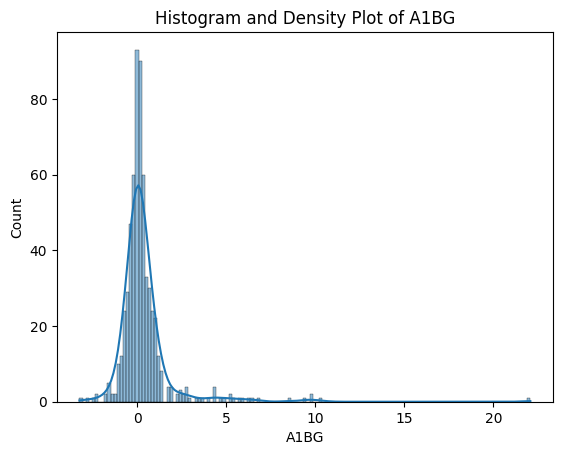

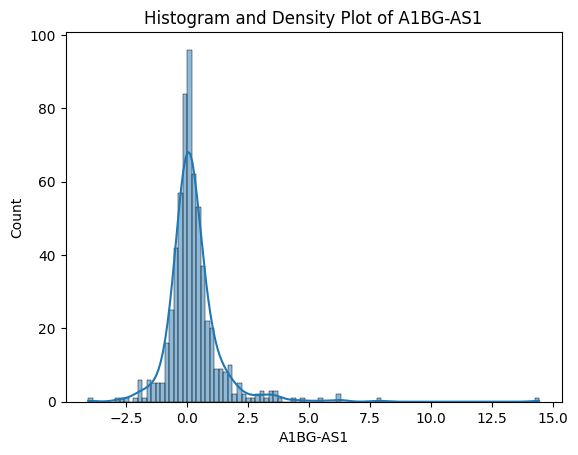

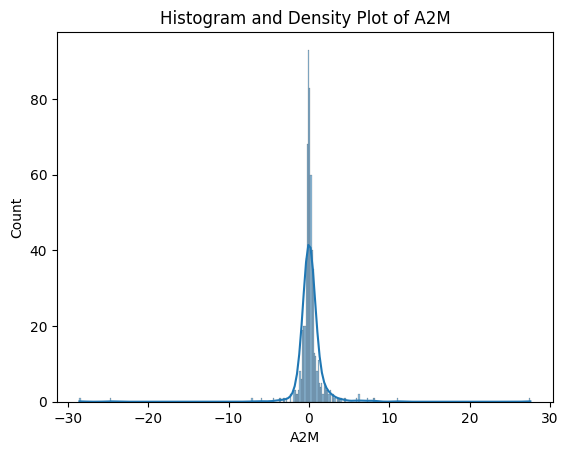

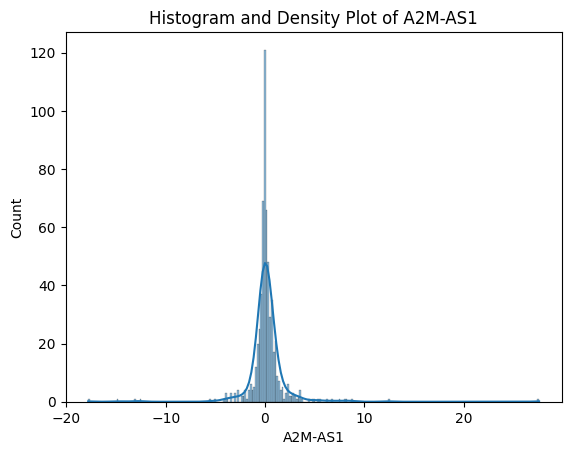

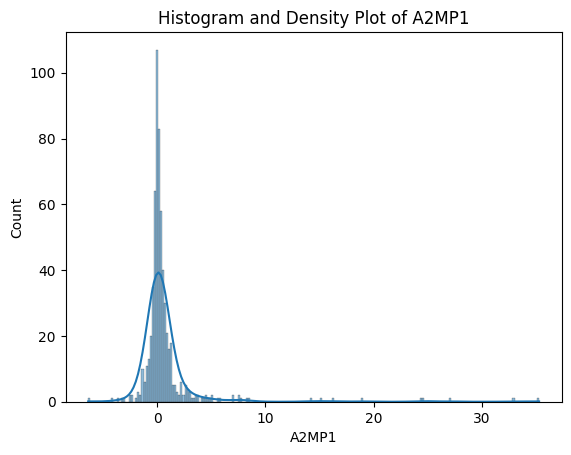

...

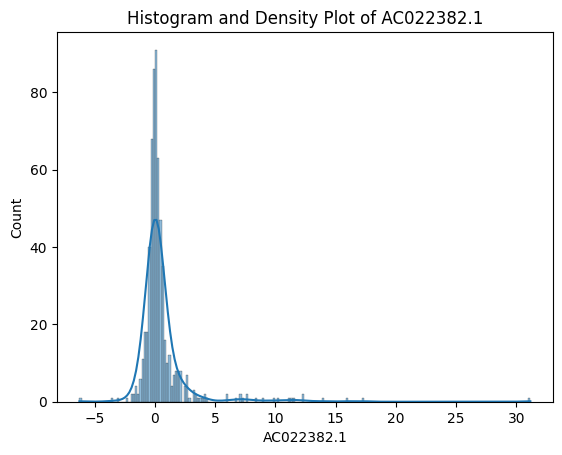

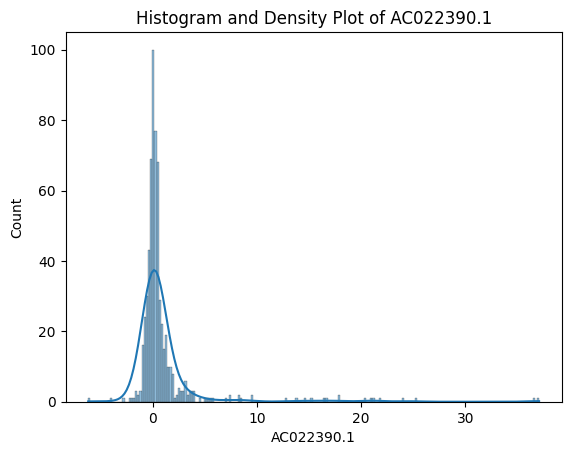

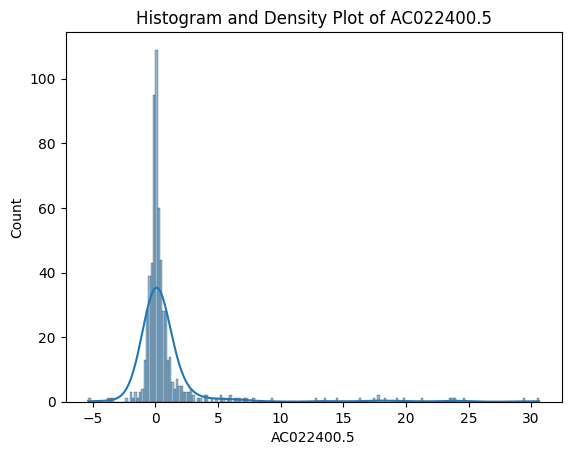

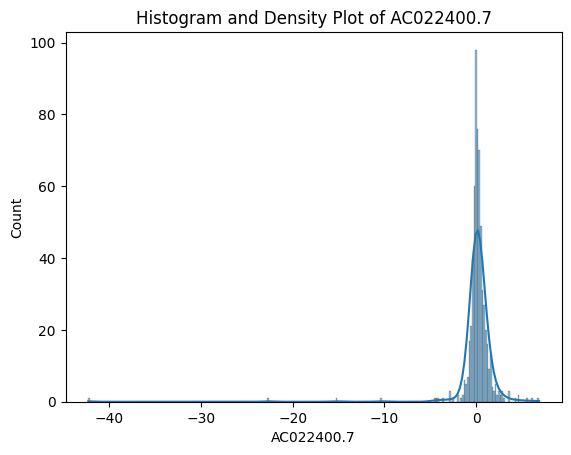

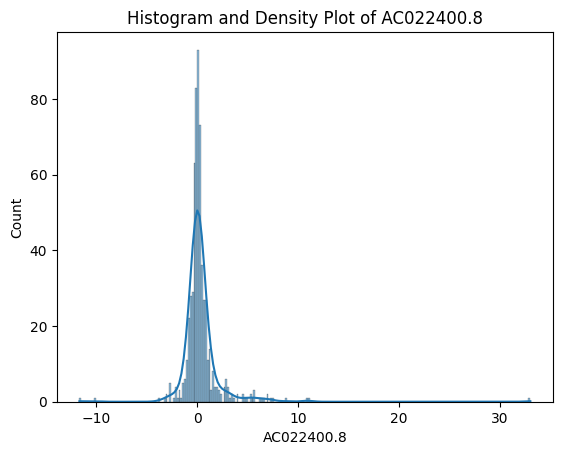

KeyboardInterrupt: 

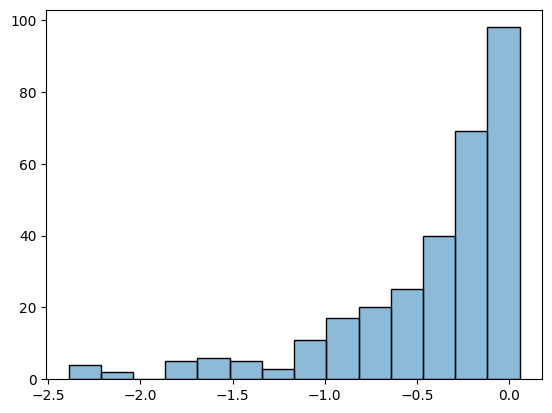

In [13]:
for col in tr_df.select_dtypes(include=['number']).columns:
    sns.histplot(tr_df[col],kde = True)
    plt.title(f"Histogram and Density Plot of {col}")
    plt.show()

In [14]:
# changing dataframe and restructuring it based on SMILE and cell type
tr_df.pivot(columns=['sm_lincs_id', 'sm_name', 'cell_type'], values='control')

sm_lincs_id     LSM-5341                                               \
sm_name     Clotrimazole                                                
cell_type       NK cells T cells CD4+ T cells CD8+ T regulatory cells   
0                  False          NaN          NaN                NaN   
1                    NaN        False          NaN                NaN   
2                    NaN          NaN        False                NaN   
3                    NaN          NaN          NaN              False   
4                    NaN          NaN          NaN                NaN   
..                   ...          ...          ...                ...   
609                  NaN          NaN          NaN                NaN   
610                  NaN          NaN          NaN                NaN   
611                  NaN          NaN          NaN                NaN   
612                  NaN          NaN          NaN                NaN   
613                  NaN          NaN          NaN                NaN   

sm_lincs_id           LSM-3349                                               \
sm_name     Mometasone Furoate                                                
cell_type             NK cells T cells CD4+ T cells CD8+ T regulatory cells   
0                          NaN          NaN          NaN                NaN   
1                          NaN          NaN          NaN                NaN   
2                          NaN          NaN          NaN                NaN   
3                          NaN          NaN          NaN                NaN   
4                        False          NaN          NaN                NaN   
..                         ...          ...          ...                ...   
609                        NaN          NaN          NaN                NaN   
610                        NaN          NaN          NaN                NaN   
611                        NaN          NaN          NaN                NaN   
612                        NaN          NaN          NaN                NaN   
613                        NaN          NaN          NaN                NaN   

sm_lincs_id   LSM-1205                ...     LSM-5218                     \
sm_name     Idelalisib                ...  Azacitidine                      
cell_type      B cells Myeloid cells  ... T cells CD8+ T regulatory cells   
0                  NaN           NaN  ...          NaN                NaN   
1                  NaN           NaN  ...          NaN                NaN   
2                  NaN           NaN  ...          NaN                NaN   
3                  NaN           NaN  ...          NaN                NaN   
4                  NaN           NaN  ...          NaN                NaN   
..                 ...           ...  ...          ...                ...   
609                NaN           NaN  ...          NaN                NaN   
610                NaN           NaN  ...          NaN                NaN   
611                NaN           NaN  ...          NaN                NaN   
612                NaN           NaN  ...          NaN                NaN   
613                NaN           NaN  ...          NaN                NaN   

sm_lincs_id     LSM-5771                                               \
sm_name     Atorvastatin                                                
cell_type       NK cells T cells CD4+ T cells CD8+ T regulatory cells   
0                    NaN          NaN          NaN                NaN   
1                    NaN          NaN          NaN                NaN   
2                    NaN          NaN          NaN                NaN   
3                    NaN          NaN          NaN                NaN   
4                    NaN          NaN          NaN                NaN   
..                   ...          ...          ...                ...   
609                  NaN          NaN          NaN              False   
610                  NaN          NaN          NaN           

In [16]:
# pulling out a list of the cell types
cell_type_list = list(tr_df['cell_type'].unique())
print(cell_type_list)
len(cell_type_list)

['NK cells', 'T cells CD4+', 'T cells CD8+', 'T regulatory cells', 'B cells', 'Myeloid cells']


6

,Number,Percent
cell_type,,
NK cells,146,0.237785
T cells CD4+,146,0.237785
T regulatory cells,146,0.237785
T cells CD8+,142,0.231270
B cells,17,0.027687
Myeloid cells,17,0.027687


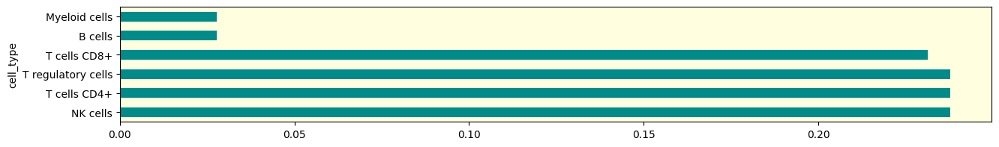

In [17]:
# VIsualizing the percent of each cell type
plt.gca().set_facecolor('lightyellow')
tr_df['cell_type'].value_counts(normalize=True).plot(kind='barh', figsize=(15,2), color=['darkcyan'])

pd.DataFrame(data= {'Number': tr_df['cell_type'].value_counts(), 
                    'Percent': tr_df['cell_type'].value_counts(normalize=True)})

# Model Training

# End Output